In [1]:
%matplotlib inline
import pandas as pd 
import numpy as np
import altair as alt
import geopandas as gpd
import gpdvega 
alt.themes.enable('opaque')

ThemeRegistry.enable('opaque')

In [253]:
tables_info = [
    (1, "1_Drugs_month"),
    (2, "2_Marijuana_year"),
    (3, "3_Marijuana_month"),
    (4, "4_Marijuana_Risk"),
    (5, "5_Marijuana_FirstUse"),
    (6, "6_NonMdrugs_month"),
    (7, "7_Cocaine_year"),
    (8, "8_Pain_Relievers_year"),
    (9, "9_Alcohol_month"),
    (10, "10_Bringe_month"),
    (11, "11_Alcohol_Risk"),
    (12, "12_12-20_alcohol_month"),
    (13, "13_tobaco_month"),
    (14, "14_cigarette_month"),
    (15, "15_Smoking_Risk"),
    (16, "16_Alcohol_DorA_year"),
    (17, "17_Alcohol_D_year"),
    (18, "18_Drugs_DorA_year"),
    (19, "19_Drugs_D_year"),
    (20, "20_DrugsOrAlcoh_DorA_year"),
    (21, "21_Drugs_NeedTreat_year"),
    (22, "22_Alcohol_NeedTreat_year"),
    (23, "23_SeriousMental_year"),
    (24, "24_AnyMental_year"),
    (25, "25_SuicideThoughts_year"),
    (26, "26_Depression_year")
]

states_abbr = {
    "Alaska": "AK",
    "Alabama": "AL",
    "Arkansas": "AR",
    "American Samoa": "AS",
    "Arizona": "AZ",
    "California": "CA",
    "Colorado": "CO",
    "Connecticut": "CT",
    "District of Columbia": "DC",
    "Delaware": "DE",
    "Florida": "FL",
    "Georgia": "GA",
    "Guam": "GU",
    "Hawaii": "HI",
    "Iowa": "IA",
    "Idaho": "ID",
    "Illinois": "IL",
    "Indiana": "IN",
    "Kansas": "KS",
    "Kentucky": "KY",
    "Louisiana": "LA",
    "Massachusetts": "MA",
    "Maryland": "MD",
    "Maine": "ME",
    "Michigan": "MI",
    "Minnesota": "MN",
    "Missouri": "MO",
    "Northern Mariana Islands": "MP",
    "Mississippi": "MS",
    "Montana": "MT",
    "National": "NA",
    "North Carolina": "NC",
    "North Dakota": "ND",
    "Nebraska": "NE",
    "New Hampshire": "NH",
    "New Jersey": "NJ",
    "New Mexico": "NM",
    "Nevada": "NV",
    "New York": "NY",
    "Ohio": "OH",
    "Oklahoma": "OK",
    "Oregon": "OR",
    "Pennsylvania": "PA",
    "Puerto Rico": "PR",
    "Rhode Island": "RI",
    "South Carolina": "SC",
    "South Dakota": "SD",
    "Tennessee": "TN",
    "Texas": "TX",
    "Utah": "UT",
    "Virginia": "VA",
    "Virgin Islands": "VI",
    "Vermont": "VT",
    "Washington": "WA",
    "Wisconsin": "WI",
    "West Virginia": "WV",
    "Wyoming": "WY"
}

tables_descriptions = {
    1: "Illicit Drugs including marijuana in the Month",
    2: "Marijuana Use in the Past Year",
    3: "Marijuana Use in the Past Month",
    4: "Perceptions of Great Risk from Smoking Marijuana Once a Month",
    5: "First Use of Marijuana",
    6: "Illicit Drug Use Other Than Marijuana in the Past Month",
    7: "Cocaine Use in the Past Year",
    8: "Nonmedical Use of Pain Relievers in the Past Year",
    9: "Alcohol Use in the Past Month",
    10: "Binge Alcohol Use in the Past Month",
    11: "Perceptions of Great Risk from Having Five or More Drinks of an Alcoholic Beverage Once or Twice a Week",
    12: "Alcohol Use in the Past Month among Individuals Aged 12 to 20",
    13: "Tobacco Product Use in the Past Month",
    14: "Cigarette Use in the Past Month",
    15: "Perceptions of Great Risk from Smoking One or More Packs of Cigarettes per Day",
    16: "Alcohol Dependence or Abuse in the Past Yearr",
    17: "Alcohol Dependence in the Past Year",
    18: "Illicit Drug Dependence or Abuse in the Past Year",
    19: "Illicit Drug Dependence in the Past Year",
    20: "Dependence or Abuse of Illicit Drugs or Alcohol in the Past Year",
    21: "Needing But Not Receiving Treatment for Illicit Drug Use in the Past Year",
    22: "Needing But Not Receiving Treatment for Alcohol Use in the Past Year",
    23: "Serious Mental Illness in the Past Year",
    24: "Any Mental Illness in the Past Year",
    25: "Had Serious Thoughts of Suicide in the Past Year",
    26: "Major Depressive Episode in the Past Year",
}

In [254]:
usa_gdf = gpd.read_file('data/states.shp')
usa_gdf.columns = ['state', 'DRAWSEQ', 'STATE_FIPS', 'SUB_REGION', 'STATE_ABBR', 'geometry']


def concat_age_groups(df, table):
    groups = []

    if table == 12:
        firs_col = 1
        last_col = 1
    elif table in [23, 24, 25]:
        firs_col = 1
        last_col = 2
    else:
        firs_col = 1
        last_col = 3

    groups_labels = df.columns[firs_col:last_col + 1]

    for column_index in range(firs_col, last_col + 1):
        groups.append(df.iloc[:, column_index:column_index + 1])
        groups[-1].columns = ["percent"]
        groups[-1]["percent"] = groups[-1]["percent"].apply(lambda x: x * 100)
        groups[-1]["age"] = groups_labels[column_index - 1]
        groups[-1]["state"] = df.iloc[:, 0]
    
    concated =  pd.concat(groups, ignore_index=True)
    return concated


def get_df(df_type, table, info):
    path = 'data/NSDUHsaeExcelTabs2014.xlsx'
    
    if df_type == 'geo':
        info_for_corr = ""
    elif df_type == 'corr':
        info_for_corr = "_" + info
    
    if table in [18, 19, 20, 26]:
        skiprows = [0, 1, 2, 3, 4, 5]
    elif table in [2, 3, 4, 7, 8, 9, 11, 14, 15]:
        skiprows = [0, 1, 2, 3]
    else:
        skiprows = [0, 1, 2, 3, 4]

    if table == 12:
        usecols = [2]
        columns = ['12-20{}'.format(info_for_corr)]
    elif table in [23, 24, 25]:
        usecols = [5, 8]
        columns = ['18-25{}'.format(info_for_corr), '26 or Older{}'.format(info_for_corr)]
    else:
        usecols = [5, 8, 11]
        columns = ['12-17{}'.format(info_for_corr), '18-25{}'.format(info_for_corr), '26 or Older{}'.format(info_for_corr)]

    if df_type == 'geo':
        usecols = [1] + usecols
        columns = ['state'] + columns

    df = pd.read_excel(
        io=path,
        sheet_name='Table {}'.format(table),
        header=0,
        usecols=usecols,
        skiprows=skiprows
    )
    df.columns = columns

    if df_type == 'geo':
        df = concat_age_groups(df, table)
        df = usa_gdf.merge(df, on='state')
        df["info"] = info
        df['state_short'] = df['state'].map(states_abbr)

    return df

In [255]:
description_df = pd.DataFrame(tables_info, columns=['table', 'info'])
description_df['description'] = description_df['table'].map(tables_descriptions)

In [256]:
geo_dfs = []

for table_info in tables_info:
    geo_df = get_df('geo', *table_info)
    geo_dfs.append(geo_df)

concated_geo_dfs = pd.concat(geo_dfs, ignore_index=True)

concated_geo_dfs['rounded_percents'] = concated_geo_dfs['percent'].astype(int)
concated_geo_dfs['rounded_percents'] = concated_geo_dfs['rounded_percents'].astype(str)
concated_geo_dfs['rounded_percents'] = concated_geo_dfs['rounded_percents'] + " %"

C:\Users\Roman\Anaconda3\envs\dataviz\lib\site-packages\ipykernel_launcher.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [262]:
def get_new_geo_chart(df, description_df):
    age_selection = alt.selection(empty='none', type="single", encodings=['x'])

    drug_selection = alt.selection(empty='none', type="single", encodings=['x'])

    color = alt.Color(
        'percent',
        scale=alt.Scale(
            domain=[0, 3, 20, 50, 80],
            range=['black', 'blue', 'purple', 'red', 'pink']
        )
    )

    bar_plot = alt.Chart(df).mark_bar().encode(
        x=alt.X(
            'state:N',
            sort=alt.EncodingSortField(field="percent", op="max", order='descending'),
            axis=alt.Axis(
                title='',
                labels=False
            )
        ),
        y=alt.Y(
            'percent',
            axis=alt.Axis(
                title=''
            )
        ),
        color=color
    ).properties(
        width=550
    ).transform_filter(
        age_selection
    ).transform_filter(
        drug_selection
    ).transform_window(
        rank='rank(percent)',
        sort=[alt.SortField('percent', order='descending')]
    ).transform_filter(
        (alt.datum.rank < 10)
    )

    geo_plot = alt.Chart(df).mark_geoshape(
        stroke='black',
        strokeWidth=0.3
    ).encode(
        color=color,
        tooltip=['state', 'percent']
    ).properties(
        projection={'type': 'albersUsa'},
        width=550,
        height=430
    ).transform_filter(
        age_selection
    ).transform_filter(
        drug_selection
    )
    
    bar_text = bar_plot.mark_text(
        baseline='bottom',
        dy=100,
        fontSize=16,
        fontWeight=600
    ).encode(
        text='state_short',
        color=alt.ColorValue("white")
    )
    
    bar_text_2 = bar_plot.mark_text(
        baseline='bottom',
        dy=130,
        fontSize=16,
        fontWeight=600
    ).encode(
        text='rounded_percents',
        color=alt.ColorValue("white")
    )
    
    age_selector = alt.Chart(df).mark_bar().encode(
        x='age',
        opacity=alt.value(0)
    ).properties(
        width=550,
    ).add_selection(
        age_selection
    ).transform_filter(
        drug_selection
    )
    
    age_selector.title = "Select Age Group"
    
    age_plot = alt.Chart(df).mark_bar().encode(
        x=alt.X(
            'age',
            axis=alt.Axis(
                title='',
                labels=False
            )
        ),
        color=alt.condition(age_selection, alt.ColorValue("grey"), alt.ColorValue("lightgrey"))
    ).properties(
        width=550,
    ).transform_filter(
        drug_selection
    )
    
    
    
    age_text = age_plot.mark_text(
        fontWeight='normal',
        baseline='bottom',
    ).encode(
        text='age',
        y=alt.value(27),
        color=alt.ColorValue("black")
    )
    
    drug_selector = alt.Chart(description_df).mark_bar().encode(
        x=alt.X(
            'info',
            axis=alt.Axis(
                title='',
                labels=False
            ),
        ),
        opacity=alt.value(0)
    ).properties(
        width=550,
    ).add_selection(
        drug_selection
    )
    
    drug_selector.title = "Select Table"
    
    drug_plot = alt.Chart(description_df).mark_bar().encode(
         x=alt.X(
            'info',
            sort=alt.EncodingSortField(field="table", op="max", order='ascending'),
            axis=alt.Axis(
                title='',
                labels=False
            ),
        ),
        color=alt.condition(drug_selection, alt.ColorValue("grey"), alt.ColorValue("lightgrey"))
    ).properties(
        width=550,
    )
    
    drug_text = drug_plot.mark_text(
        fontWeight='normal',
        baseline='bottom',
    ).encode(
        text='table',
        y=alt.value(27),
        color=alt.ColorValue("black")
    )
    
    description = alt.Chart(description_df).mark_text(
        fontWeight='normal',
        align='center'
    ).encode(
        text='description',
        color=alt.ColorValue("black")
    ).properties(
        width=550,
    ).transform_filter(
        drug_selection
    )
    
    description.title = "Data Description"

    final = alt.vconcat(
        alt.layer(bar_plot, bar_text, bar_text_2),
        description,
        geo_plot,
        alt.layer(age_plot, age_text, age_selector),
        alt.layer(drug_selector, drug_plot, drug_text),
    ).properties().configure_axis(
        domainColor='#FFFFFF',
        labelColor='#999999',
        tickColor='#FFFFFF',
        grid=False
    ).configure_view(
        strokeWidth=0
    ).configure_mark(
        radius=10
    ).configure_axisY(
        titleFontWeight=200
    )
    
    final.title = "Results of the 2014 National Survey on Drug Use and Health"
    return final

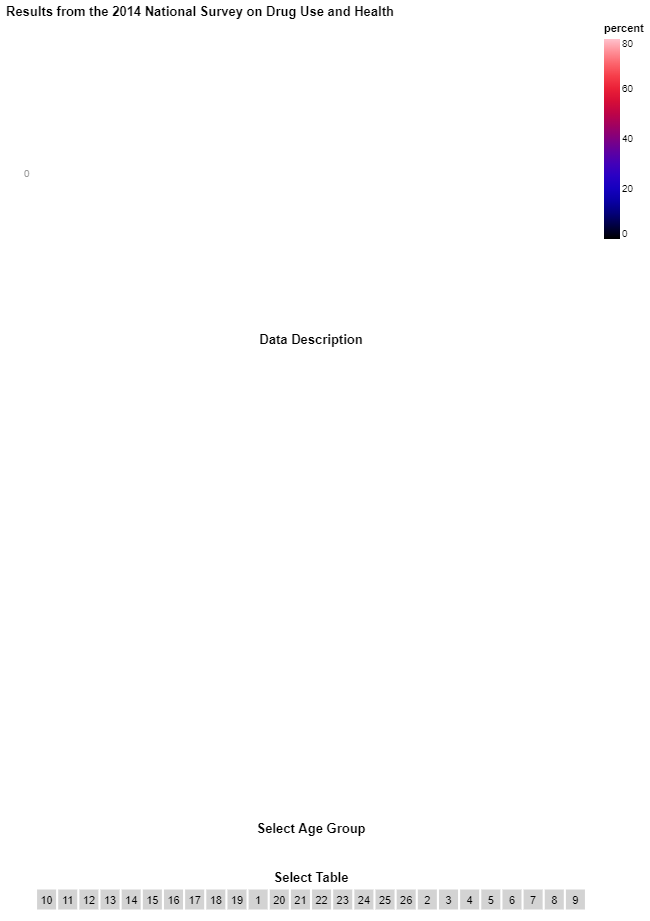

In [263]:
get_new_geo_chart(concated_geo_dfs, description_df)